# Notebook for Python Practice Problems - Programming Exercise and Data Exploration Exercise

In [1]:
from datetime import date

today = date.today()

today

datetime.date(2020, 8, 4)

## Edabit site with python daily challenges in Pyresearch book

# 08/03/2020

In [2]:
import pandas as pd
import numpy as np

In [3]:
# Write a function that returns the string "something" joined with a space and the given parameter a.

def something(a:str) -> str:
    
    return "something " + a

something('something')

'something something'

In [4]:
# Data Exploration of DC crashes - looks like 2019 but doesnt clarify in metadata

from pandas.io.json import json_normalize
import requests


#import DC crashes json
crashes_url = 'https://opendata.arcgis.com/datasets/70248b73c20f46b0a5ee895fc91d6222_25.geojson'
crashes_json = requests.get(crashes_url).json()

crashes_results = crashes_json['features']

crashes_results[0]['properties']

{'OBJECTID': 337254503,
 'CRIMEID': 27211616,
 'CCN': '17022140',
 'PERSONID': 85358389,
 'PERSONTYPE': 'Driver',
 'AGE': 29,
 'FATAL': 'N',
 'MAJORINJURY': 'N',
 'MINORINJURY': 'N',
 'VEHICLEID': '2957119',
 'INVEHICLETYPE': 'Passenger Car/automobile',
 'TICKETISSUED': 'N',
 'LICENSEPLATESTATE': 'WY',
 'IMPAIRED': 'N',
 'SPEEDING': 'N'}

In [5]:
# df from json

class json_convert_drop(object):
    
    """ Class that:
    Normalizes json then
    Sets columns names then 
    Drops columns that were not renamed.
    """
    
    def __init__(self,data):
        self.df = pd.json_normalize(data)
        self.columns = list(self.df.columns.values)

    def __enter__(self):
        return self.df

    def __exit__(self, exc_type, exc_val, exc_tb):
        self.df.drop([c for c in self.columns], axis=1, inplace=True)
        
        
with json_convert_drop(crashes_results) as crashes:
    
    crashes['license_plate'] = crashes['properties.LICENSEPLATESTATE']
    crashes['age'] = crashes['properties.AGE']
    crashes['fatal'] = crashes['properties.FATAL']
    crashes['major_injury'] = crashes['properties.MAJORINJURY']
    crashes['minor_injury'] = crashes['properties.MINORINJURY']
    crashes['impaired'] = crashes['properties.IMPAIRED']
    crashes['ticket'] = crashes['properties.TICKETISSUED']
    crashes['speeding'] = crashes['properties.SPEEDING']
    
crashes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569950 entries, 0 to 569949
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   license_plate  569950 non-null  object 
 1   age            400313 non-null  float64
 2   fatal          569950 non-null  object 
 3   major_injury   569950 non-null  object 
 4   minor_injury   569950 non-null  object 
 5   impaired       569950 non-null  object 
 6   ticket         569950 non-null  object 
 7   speeding       569950 non-null  object 
dtypes: float64(1), object(7)
memory usage: 34.8+ MB


In [6]:
crashes = crashes.dropna(axis = 0, how = 'any')

In [7]:
crashes.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 400313 entries, 0 to 569947
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   license_plate  400313 non-null  object 
 1   age            400313 non-null  float64
 2   fatal          400313 non-null  object 
 3   major_injury   400313 non-null  object 
 4   minor_injury   400313 non-null  object 
 5   impaired       400313 non-null  object 
 6   ticket         400313 non-null  object 
 7   speeding       400313 non-null  object 
dtypes: float64(1), object(7)
memory usage: 27.5+ MB


In [8]:
crashes.age.value_counts()

 26.0     11334
 27.0     11315
 25.0     11286
 28.0     11253
 29.0     11047
          ...  
-47.0         1
-38.0         1
-33.0         1
 124.0        1
-13.0         1
Name: age, Length: 170, dtype: int64

In [9]:
# avoid masks when slicing with index drop

age_index_drop = crashes[(crashes.age < 16) | (crashes.age > 120) ].index

crashes.drop(age_index_drop, inplace = True)

crashes.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 382549 entries, 0 to 569947
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   license_plate  382549 non-null  object 
 1   age            382549 non-null  float64
 2   fatal          382549 non-null  object 
 3   major_injury   382549 non-null  object 
 4   minor_injury   382549 non-null  object 
 5   impaired       382549 non-null  object 
 6   ticket         382549 non-null  object 
 7   speeding       382549 non-null  object 
dtypes: float64(1), object(7)
memory usage: 26.3+ MB


In [10]:
crashes.age.value_counts()

26.0     11334
27.0     11315
25.0     11286
28.0     11253
29.0     11047
         ...  
112.0        5
111.0        5
106.0        2
107.0        2
110.0        2
Name: age, Length: 105, dtype: int64

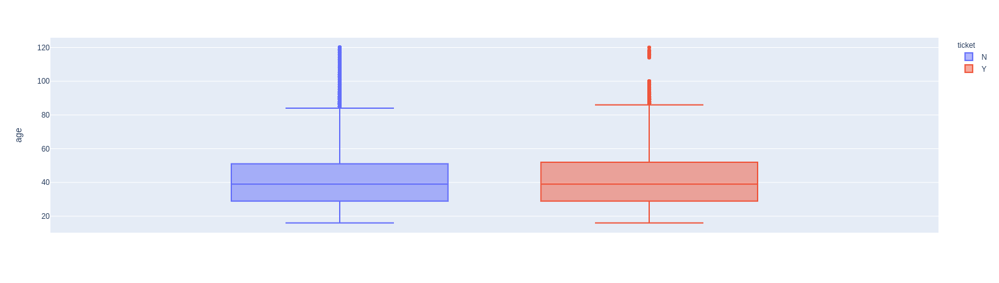

In [23]:
import plotly.express as px

fig = px.box(crashes, y='age', color = 'ticket')
fig.show()

### It appears that a larger amount of outliers existed for persons that did not receive a ticket after a crash occured, versus those that were ticketed after a crash occured. It does not appear that age had a strong indication that a person would or would not receive a ticket after a crash occured, given that the interquartile ranges for both persons that were ticketed, and were not ticketed were nearly identical. 

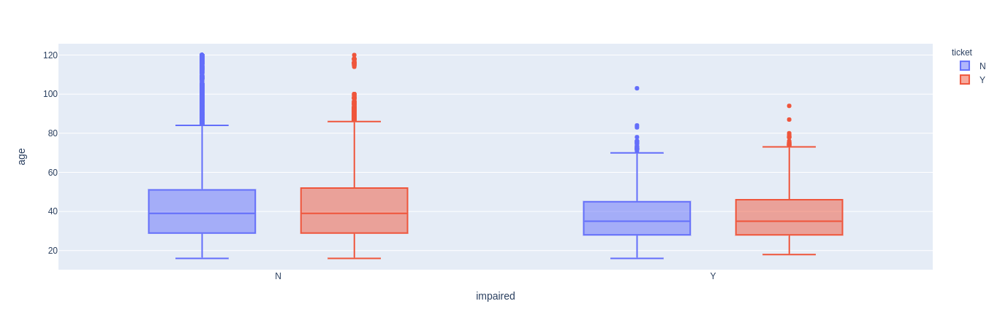

In [24]:
fig = px.box(crashes, x='impaired', y='age', color = 'ticket')
fig.show()

In [35]:
crashes.groupby(by = 'impaired').mean()

,age
impaired,
N,40.967915
Y,37.412201


### In DC it is more likely to have a driver that crashes, is impaired and gets a ticket at a younger age than someone who crashes and gets a ticket who is not impaired. The average age of someone in DC who crashes and is impaired is on average 4 years younger than someone who gets into a crash and is not impaired.

ImportError: Cumulative distributions are currently only implemented in statsmodels. Please install statsmodels.

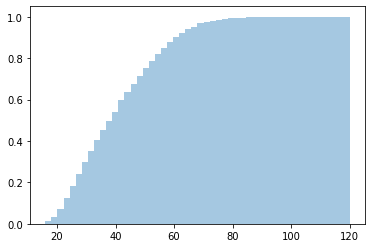

In [26]:
import seaborn as sns

kwargs = {'cumulative': True}

sns.distplot(crashes.age, hist_kws = kwargs, kde_kws = kwargs)

In [30]:
crashes.age.describe()

count    382549.000000
mean         40.930281
std          14.737312
min          16.000000
25%          29.000000
50%          39.000000
75%          51.000000
max         120.000000
Name: age, dtype: float64

### The average age of someone in a crash in DC and is on record is about 41 yrs old.  

# 08/04/20

In [1]:
import pandas as pd
import numpy as np

In [11]:
# Establish if a given integer num is a Curzon number. 
# If 1 plus 2 elevated to num is exactly divisible by 1 plus 2 multiplied by num, then num is a Curzon number.
# Given a non-negative integer num, implement a function that returns True if num is a Curzon number, or False otherwise.

def is_curzon(num: int) -> bool:
    
    if (1 + 2 ** num) % (1 + 2 * num) == 0:
        return True
    else:
        return False

In [22]:
is_curzon(6)

True

In [21]:
for i in range(1,50):
    print(is_curzon(i))

True
True
False
False
True
True
False
False
True
False
False
False
False
True
False
False
False
True
False
False
True
False
False
False
False
True
False
False
True
True
False
False
True
False
False
False
False
False
False
False
True
False
False
False
False
False
False
False
False


# 08/07/20

In [2]:
# Data Exploration of DC - Motor Vehicle Citations using MySQL to query local database conncection

import mysql.connector as sql
import config
# Set the permissions for local MySQL connection
database = sql.connect(host = config.host,
                       user = config.user,
                       passwd = config.passwd)

print(database)

In [3]:
# Set the database and cursor (look up cursor)

cursor = database.cursor(buffered = True, dictionary = True)

query = "SELECT CITATION_DATE, CODE, CODE_DESCRIPTION FROM DC_Data.motorvehicle_citations"

# Obtain the records in table
cursor.execute(query)

# Get column names from table
columns = cursor.column_names

# Fetch the rows of data from the cursor object
rows = cursor.fetchall()


In [4]:
# set citations df from column names and rows from query
citations = pd.DataFrame(rows, columns = columns)

In [5]:
# Changing column headers to lowercase
citations.columns = map(str.lower, citations.columns)

In [10]:
tickets = citations.groupby(by = 'code_description').count()

In [18]:
pd.set_option('display.max_rows', None)
tickets.sort_values('code', ascending = False).head(20)

,citation_date,code
code_description,,
FAIL TO USE SEAT BELT,15661,15661
PASSING STOP SIGN,12925,12925
DISOBEYING OFFICIAL SIGN OR SIGNAL DEVICE,12203,12203
FAILURE TO PROVIDE PROOF OF INSURANCE,10492,10492
UP TO 10 MPH IN EXCESS OF SPEED LIMIT,10269,10269
UNREASONABLE SPEED,8625,8625
11 TO 15 MPH IN EXCESS OF SPEED LIMIT,8280,8280
16 TO 20 MPH IN EXCESS OF SPEED LIMIT,8257,8257
CELL PHONE OR OTHER DEVICE,6698,6698


## After filtering out the top 20 motor vehicle citations, failure to use a seatbelt and failure to obey official signage are the top infractions commited while driving in DC. 

In [23]:
tickets['%total'] = tickets.code / tickets.code.sum() * 100
tickets.sort_values('%total', ascending = False).head(20)

,citation_date,code,%total
code_description,,,
FAIL TO USE SEAT BELT,15661,15661,7.700288
PASSING STOP SIGN,12925,12925,6.355036
DISOBEYING OFFICIAL SIGN OR SIGNAL DEVICE,12203,12203,6.000039
FAILURE TO PROVIDE PROOF OF INSURANCE,10492,10492,5.158765
UP TO 10 MPH IN EXCESS OF SPEED LIMIT,10269,10269,5.049119
UNREASONABLE SPEED,8625,8625,4.240788
11 TO 15 MPH IN EXCESS OF SPEED LIMIT,8280,8280,4.071157
16 TO 20 MPH IN EXCESS OF SPEED LIMIT,8257,8257,4.059848
CELL PHONE OR OTHER DEVICE,6698,6698,3.293310


## The distribution of the amount of citations is fairly uniform across the top 20 citations given, accounting for about 65% of all citations. The rest of the individual types of citations given all only account for about 1% or less of the total citations given. 

## An individual is as equally likely to receive a ticket for not wearing a seatbelt as they are failing to stop at a stop sign in DC. Given that a seat belt offense within DC allows officers to pull the vehicle over, it seems like a likely way for an officer to pull over most vehicles at-will, givent that being able to see a seatbelt not properly worn is pretty difficult.

In [27]:
tickets['%total'].sort_values(ascending = False)[:20].sum()

64.66058943269316

In [44]:
import plotly.express as px

fig = px.bar()

fig.show()

# 08/08/20

### Create a function that takes a number as an argument and returns "Fizz", "Buzz" or "FizzBuzz".
- If the number is a multiple of 3 the output should be "Fizz".
- If the number given is a multiple of 5, the output should be "Buzz".
- If the number given is a multiple of both 3 and 5, the output should be "FizzBuzz".
- If the number is not a multiple of either 3 or 5, the number should be output on its own as shown in the examples below.
- The output should always be a string even if it is not a multiple of 3 or 5.

In [29]:
def fizzbuzz(number: int) -> str:
    

    if number % 15 == 0:
        print('FizzBuzz')
    elif number % 3 == 0:
        print('Fizz')
    elif number % 5 == 0:
        print('Buzz')
    else:
        return str(number)

In [32]:
fizzbuzz(5)

Buzz


### Smart Alternative to same question above using FizzBzz as string combination and then return string of number entered if other values are 0's.

In [34]:
def fizzbuzz(number: int) -> str:
    
    return "Fizz" * (number%3 == 0) + "Buzz" * (number%5 == 0) or str(num)

In [35]:
fizzbuzz(5)

'Buzz'

In [36]:
fizzbuzz(45)

'FizzBuzz'

In [37]:
def returntest(number):
    
    return "two" * (number%2 == 0) or "three" * (number%3 == 0) or "neither"

In [38]:
returntest(2)

'two'

In [43]:
returntest(11)

'neither'

In [46]:
number = 2

step1 = number%2 == 0

print(step1)

True


In [47]:
step1 * 5

5

In [48]:
step1*"two"

'two'

# 08/09/20

In [7]:
# Given two lines, determine whether or not they are parallel.

# Lines are represented by a list [a, b, c], which corresponds to the line ax+by=c.
from typing import List


def parallel(line1: List[int], line2: List[int]) -> bool:
    
    if (line1[0] == line2[0]) & (line1[2] != line2[2]):
        print('The lines are parallel')
    else:
        print('The lines are not parallel')
        

In [9]:
parallel([1,2,3],[1,2,4])

The lines are parallel


# 08/16/20


In [24]:
from typing import Dict


def profit(balance_sheet: Dict[str, int]) -> int:
    
    try:
        
        total_revenue = balance_sheet.get('sale_price', "Missing Data") * balance_sheet.get('quantity', "Missing Data")
        
        total_costs = balance_sheet.get('cost', "Missing Data") * balance_sheet.get('quantity', "Missing Data")
        
        profit = total_revenue - total_costs
    
        print(profit)
        
    except:
        
        print("Missing or mislabeled data in Balance Sheet")
    

In [26]:
profit({'cost': 10, 'sale_price': 15, 'quantity': 1})


5


# Try and Except used in functino above to raise error message to user^^^^^^

# 08/19/20

In [39]:
# Create a class that takes the following four arguements for a particular football player:

# name
# age
# height
# weight

# Also, create three functions for the class that returns the following strings:

# get_age() returns "name is age"
# get_height() returns "name is height"
# get_weight() returns "name weighs weight"


class Player():
    
    def __init__(self, name: str, age: int, height: int, weight: int):
        
        self.name = name
        self.age = age
        self.height = height
        self.weight = weight
        
    def get_age(self):
        
        try:
            age = int(input('Enter a number: '))
            
            assert(age > 0), "Please enter a valid age"
            
            print(f'{self.name} is {age} years old')
            
        except:
            print("Error in Player data")
            
    def get_height(self):
        
        try:
            print(f'{self.name} is {self.height} inches tall')
        except:
            print("Error in Player data")
            
    def get_weight(self):
        
        try:
            print(f'{self.name} is {self.weight} lbs')
        
        except:
            print("Error in Player data")
            

In [44]:
jack = Player("Jack", 0, 72, 220)

jack.get_age()

Enter a number:  -1


Error in Player data


# Try and except used in combination with assert test above^^^^

# 09/1/20

## Switching to 100 pandas problems on github repo in PyResearch folder

In [95]:
# 1. Import pandas
# 2. Print the version of pandas

import pandas as pd

pd.__version__

'1.1.0'

In [96]:
# 3. Print all the version info required by pandas

pd.show_versions()


INSTALLED VERSIONS
------------------
commit           : d9fff2792bf16178d4e450fe7384244e50635733
python           : 3.7.7.final.0
python-bits      : 64
OS               : Linux
OS-release       : 5.4.0-48-generic
Version          : #52~18.04.1-Ubuntu SMP Thu Sep 10 12:50:22 UTC 2020
machine          : x86_64
processor        : x86_64
byteorder        : little
LC_ALL           : None
LANG             : en_US.UTF-8
LOCALE           : en_US.UTF-8

pandas           : 1.1.0
numpy            : 1.19.1
pytz             : 2020.1
dateutil         : 2.8.1
pip              : 20.1.1
setuptools       : 47.1.1
Cython           : None
pytest           : None
hypothesis       : None
sphinx           : None
blosc            : None
feather          : None
xlsxwriter       : None
lxml.etree       : None
html5lib         : None
pymysql          : None
psycopg2         : None
jinja2           : None
IPython          : 7.17.0
pandas_datareader: None
bs4              : None
bottleneck       : None
fsspec   

In [97]:
# 4. Create a DataFrame df from this dictionary data which has the index labels.

import numpy as np

data = {'animal': ['cat', 'cat', 'snake', 'dog', 'dog', 'cat', 'snake', 'cat', 'dog', 'dog'],
        'age': [2.5, 3, 0.5, np.nan, 5, 2, 4.5, np.nan, 7, 3],
        'visits': [1, 3, 2, 3, 2, 3, 1, 1, 2, 1],
        'priority': ['yes', 'yes', 'no', 'yes', 'no', 'no', 'no', 'yes', 'no', 'no']}

labels = ['a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j']

df = pd.DataFrame(data, index = labels)

df

,animal,age,visits,priority
a,cat,2.5,1,yes
b,cat,3.0,3,yes
c,snake,0.5,2,no
d,dog,NaN,3,yes
e,dog,5.0,2,no
f,cat,2.0,3,no
g,snake,4.5,1,no
h,cat,NaN,1,yes
i,dog,7.0,2,no
j,dog,3.0,1,no


In [98]:
# 5. Display a summary of the basic information about this DataFrame and its data 
# (hint: there is a single method that can be called on the DataFrame).

df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 10 entries, a to j
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   animal    10 non-null     object 
 1   age       8 non-null      float64
 2   visits    10 non-null     int64  
 3   priority  10 non-null     object 
dtypes: float64(1), int64(1), object(2)
memory usage: 400.0+ bytes


In [99]:
# 6. Return the first 3 rows of the DataFrame df.

df.head(3)

,animal,age,visits,priority
a,cat,2.5,1,yes
b,cat,3.0,3,yes
c,snake,0.5,2,no


In [100]:
# 7. Select just the 'animal' and 'age' columns from the DataFrame df.

df[['animal', 'age']]

,animal,age
a,cat,2.5
b,cat,3.0
c,snake,0.5
d,dog,NaN
e,dog,5.0
f,cat,2.0
g,snake,4.5
h,cat,NaN
i,dog,7.0
j,dog,3.0


# 09/26/20

In [101]:
# 8. Select the data in rows [3, 4, 8] and in columns ['animal', 'age'].

df.loc[df.index[[3,5,8]], ['animal', 'age']]

,animal,age
d,dog,NaN
f,cat,2.0
i,dog,7.0


In [102]:
# 9. Select only the rows where the number of visits is greater than 3.

df.head

df_visits = df[df['visits'] > 2]

df_visits

,animal,age,visits,priority
b,cat,3.0,3,yes
d,dog,NaN,3,yes
f,cat,2.0,3,no


In [103]:
# 10. Select the rows where the age is missing, i.e. it is NaN.

df_age_missing = df[df.age.isna()]

df_age_missing

,animal,age,visits,priority
d,dog,NaN,3,yes
h,cat,NaN,1,yes


In [104]:
# 11. Select the rows where the animal is a cat and the age is less than 3.

df_cat_3 = df[ (df.animal == 'cat') & (df.age < 3) ]

df_cat_3

,animal,age,visits,priority
a,cat,2.5,1,yes
f,cat,2.0,3,no


In [105]:
# 12. Select the rows the age is between 2 and 4 (inclusive).

df_age_2to4 = df[ (df.age >= 2) & (df.age <= 4) ]

df_age_2to4

,animal,age,visits,priority
a,cat,2.5,1,yes
b,cat,3.0,3,yes
f,cat,2.0,3,no
j,dog,3.0,1,no


In [126]:
# 13. Change the age in row 'f' to 1.5.

# df.loc[df.index == 'f', 'age'] = 1.5

# df_age_f = df.age[df.index == 'f'] = 1.5

df.loc['f', 'age'] = 1.5

df

,animal,age,visits,priority
a,cat,2.5,1,yes
b,cat,3.0,3,yes
c,snake,0.5,2,no
d,dog,NaN,3,yes
e,dog,5.0,2,no
f,cat,1.5,3,no
g,snake,4.5,1,no
h,cat,NaN,1,yes
i,dog,7.0,2,no
j,dog,3.0,1,no


In [109]:
# 14. Calculate the sum of all visits in df (i.e. find the total number of visits).

visits_sum = df.visits.sum()

visits_sum

19

In [111]:
# 15. Calculate the mean age for each different animal in df.

mean_age_animals = df.groupby('animal').mean()

mean_age_animals

,age,visits
animal,,
cat,2.333333,2.0
dog,5.000000,2.0
snake,2.500000,1.5


In [119]:
# 16. Append a new row 'k' to df with your choice of values for each column. 
# Then delete that row to return the original DataFrame.


df.loc['k'] = ['iguana', 33.0, 10, 'yes']

print(df)

df.drop('k', inplace = True)

print(df)

   animal   age  visits priority
a     cat   2.5       1      yes
b     cat   3.0       3      yes
c   snake   0.5       2       no
d     dog   NaN       3      yes
e     dog   5.0       2       no
f     cat   1.5       3       no
g   snake   4.5       1       no
h     cat   NaN       1      yes
i     dog   7.0       2       no
j     dog   3.0       1       no
k  iguana  33.0      10      yes
  animal  age  visits priority
a    cat  2.5       1      yes
b    cat  3.0       3      yes
c  snake  0.5       2       no
d    dog  NaN       3      yes
e    dog  5.0       2       no
f    cat  1.5       3       no
g  snake  4.5       1       no
h    cat  NaN       1      yes
i    dog  7.0       2       no
j    dog  3.0       1       no


In [125]:
# 17. Count the number of each type of animal in df.

df.animal.value_counts()

dog      4
cat      4
snake    2
Name: animal, dtype: int64